In [1]:
# Copyright 2020 Fabian Hofmann
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# (1) Conditional Generative Adversarial Network for Video with Untangled Encoded Video Input

This notebook provides an introduction to our proposed extension and modification to the VGAN and C-VGAN model: While a conditional VGAN model is able to generate a video out of a single frame, the input frame does not encompass any motion dynamics -- it is a static frame. However, in our use-case, we have a continuous video stream, giving us the opportunity to work with more than one input frame at a time to to learn motion dynamics and improve our prediction quality.

Furthermore, the frame that is encoded into latent code in C-VGAN, is the same for both background and foreground of the VGAN model. This creates issues when there are the same motion dynamics but in front of a different background, which was highlighted by Spampinato et al.. Their adjusted model for video generation and object segmentation (VOS-GAN), includes a separation of the inputs for background and foreground. This untanglement of the two latent spaces was the main inspiration, but unlike them utilize this untanglement for not a classical video generation model but a conditional one (i.e. one that is fed multiple input frames).

Therefore, we first adjust the encoder of our already implemented C-VGAN model, to accept N frames as input and encode this with into 3 dimensional latent space, keeping the time dimension intact, but only for the foreground stream. The Background stream encodes input videos into a separate 2 dimension space. This way, we hope to generate N+1 frames out of N input frames, thus predicting the next frame. Second, we improve upon our new model by replacing one or more of the 3D convolutions of the encoder with convolutional (2D) LSTM nodes, that will help the model to further understand the temporal causality within the video and make the N+1 prediction. This will be done near the bottleneck of the model. Lastly, we may widen the bottleneck of the generator and thus increase the memory capacity / expressiveness of these layers. Spampinato et al. do this by replacing some of the fractional strided convolutions (deconvolutions) with residual deconvolutional layers.

##### Sources
- [VGAN by Vondrick et al](http://www.cs.columbia.edu/~vondrick/tinyvideo/)
- [VOS-GAN by Spampinato et al.](https://arxiv.org/pdf/1803.09092.pdf)
- [Our implementation of VGAN](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb)
- [Our implementation of C-VGAN](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan_conditional.ipynb)

## Setup

In [2]:
import tensorflow as tf

tf.__version__

'2.1.0'

In [3]:
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")

Default GPU Device: /device:GPU:0


In [4]:
import numpy as np
import os
import time

from IPython import display
from matplotlib import pyplot as plt

# git+https://github.com/tensorflow/docs
import tensorflow_docs.vis.embed as embed

from src.io_.batch_generator import UniformBatchGenerator, BatchLoader
from src.io_.gif_writer import write_gif_grid
from src.models.vgan import *

In [5]:
base_input_path = "../../data/upCam/preprocessed_128_64/"
base_output_path = "../../output/models/vgan/vgan_conditional_3d/"

## Instantiate the batch generator and examples

The discriminator is trained on ~1.5 second (8 frames) long video clips (`train_y`), sampled from the created video dataset, while the conditional generator has to generate videos resembling real ones, while also fitting the first 7 frames of its generated video to its input (`train_x`).

In [6]:
BATCH_SIZE = 64

days = ["00", "01", "02", "03", "04"]
day_paths = [base_input_path + day + "/" for day in days]

uniform_sampler = UniformBatchGenerator(day_paths=day_paths, batch_size=BATCH_SIZE, sample_size=8, subsample_size=7)

train_x, train_y = uniform_sampler[0]
assert np.shape(train_x) == (64, 7, 64, 128, 3) # (samples, frames, height, width, channels)
assert np.shape(train_y) == (64, 8, 64, 128, 3) # (samples, frames, height, width, channels)

To check up on the generator's training progress later (qualitatively, not quantitatively), we once again sample 16 video clips out of the first batch.


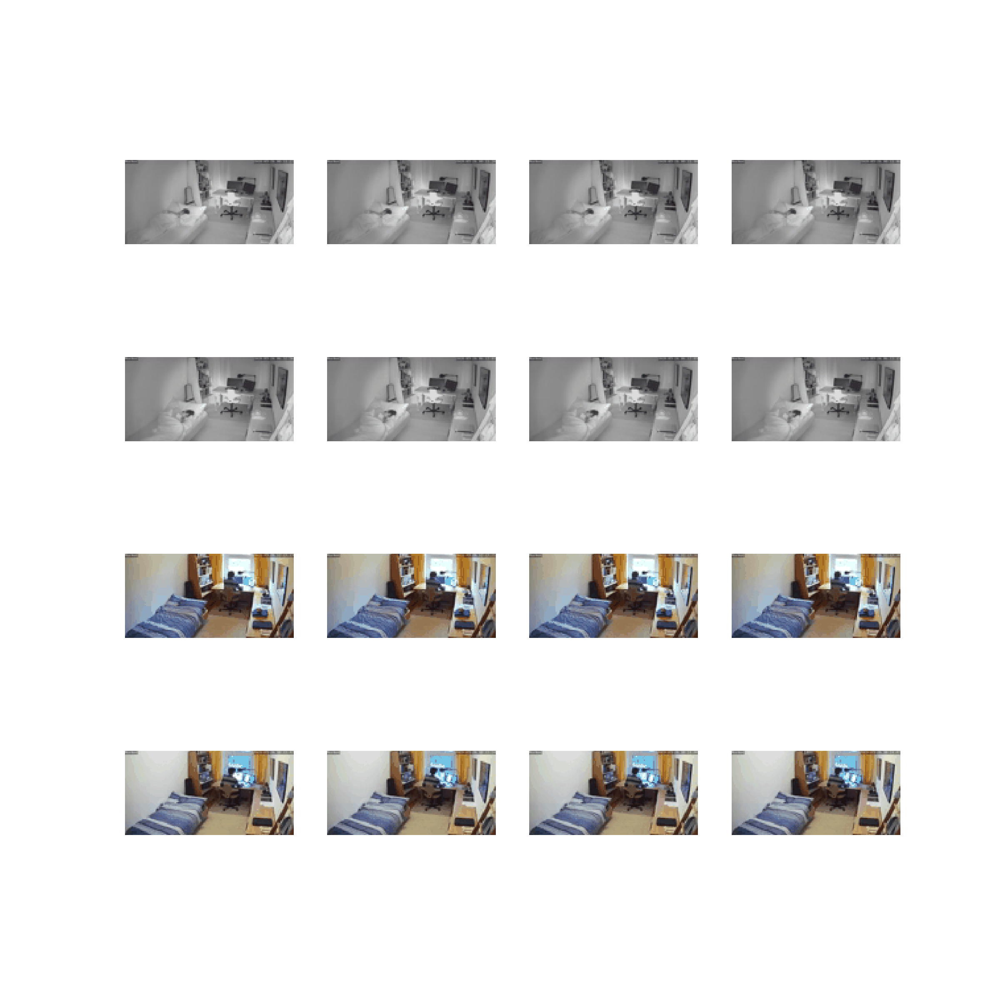

In [7]:
examples_input = train_x[::4]   # will be used as example input later
examples_output = train_y[::4]

image_file_grid = base_output_path + "anim/example_frame_grid.gif"

write_gif_grid(image_file_grid, examples_output, fps=5, dpi=600)
embed.embed_file(image_file_grid)

## Create the models

### The Generator

As with our implementation of C-VGAN, we chose to keep the model of foreground and background stream (and their combiner) as they are -- for now. At this point in time, we are only modifying how the latent code to the two streams is created. As explained at the beginning of this notebook, we chose to separate the two streams entirely, from start to combiner. This gives both streams a chance to encode the input to a latent space that matters to them (i.e. the background latent space should merely include the background information of the videos, while the foreground learns the motion dynamics of non static objects).

While the two encoders are different in some details they have some similarities in their configuration:
- The encoders are both modified inverses of our streams in structure, downsampling the `64x128` input with three channels (one additional dimension for the foreground video input) to a resolution of `2x4` with 1024 channels.
- If not noted otherwise, strided convolutions with kernel size of `3` and stride of `2` are used.
- All convolutional layers use batch normalization and ReLU activation. The first layer of each encoder does not use batch norm.
- Weights are initialized with `tf.keras.initializers.HeNormal`.

#### Foreground Encoder

Similar to our C-VGAN encoder, we decided to use 5 layers to encode the input video to latent space. But because we have a space-time cuboid as input (i.e. a video), we need to use spatio-temporal convolutions instead of regular spatio convolutions to maintain temporal relationships between frames. As with our foreground stream (but reverse) we decrease the time component of the space only every second layer.

In [8]:
def make_foreground_encoder_stream(inputs: tf.Tensor) -> tf.Tensor:
    x: tf.Tensor = layers.Conv3D(filters=64, kernel_size=3, strides=(1, 2, 2),
                                 padding="same", use_bias=False, kernel_initializer="he_normal")(inputs)
    assert x.shape.as_list() == [None, 7, 32, 64, 64]
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=128, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 4, 16, 32, 128]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=256, kernel_size=3, strides=(1, 2, 2),
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 4, 8, 16, 256]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=512, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 2, 4, 8, 512]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=1024, kernel_size=3, strides=(1, 2, 2),
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 2, 2, 4, 1024]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    return x

#### Background Encoder

The encoder to the latent space of the background stream input is very similar to the foreground one, with the difference, that a stride size of `2` is kept for all dimensions on each layer - thus quickly reducing the time dimension, before the tensor can be reshaped to fit spatio convolutions (2D) instead. This way, we hope we can force the background encoder, to focus on background details, while hindering it from learning any details of moving objects.

One could argue, that one could just use the first frame of video input and apply regular spatio convolutions to it, but we think otherwise, because movement of objects might show static objects in the background that are necessary to model a real scene. Otherwise these details would get modelled by the foreground stream which is not intended by us.

In [9]:
def make_background_encoder_stream(inputs: tf.Tensor) -> tf.Tensor:
    x: tf.Tensor = layers.Conv3D(filters=64, kernel_size=3, strides=2,
                                 padding="same", use_bias=False, kernel_initializer="he_normal")(inputs)
    assert x.shape.as_list() == [None, 4, 32, 64, 64]
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=128, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 2, 16, 32, 128]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv3D(filters=256, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 1, 8, 16, 256]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Reshape((8, 16, 256))(x)
    x = layers.Conv2D(filters=512, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 4, 8, 512]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    x = layers.Conv2D(filters=1024, kernel_size=3, strides=2,
                      padding="same", use_bias=False, kernel_initializer="he_normal")(x)
    assert x.shape.as_list() == [None, 2, 4, 1024]
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

    return x

#### Update the generator model with the new encoders

As with the old conditional VGAN, not much has to be changed. The encoded inputs for both foreground and background can be directly passed to their respective streams. As with C-VGAN, we outsourced the sub-models into a separate [module](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py).

In [10]:
def make_generator_model() -> keras.Model:
    inputs: tf.Tensor = keras.Input(shape=(7, 64, 128, 3))

    e_3d = make_foreground_encoder_stream(inputs)
    f, m = make_generator_foreground_stream(e_3d)

    e_2d = make_background_encoder_stream(inputs)
    b = make_generator_background_stream(e_2d)

    outputs = make_generator_stream_combiner(f, m, b)

    return keras.Model(inputs=inputs, outputs=outputs, name="c_vgan_generator")

Create the generator model, and check the model summary:

In [11]:
c_vgan_generator = make_generator_model()
c_vgan_generator.summary()

Model: "c_vgan_generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 7, 64, 128,  0                                            
__________________________________________________________________________________________________
conv3d (Conv3D)                 (None, 7, 32, 64, 64 5184        input_1[0][0]                    
__________________________________________________________________________________________________
conv3d_5 (Conv3D)               (None, 4, 32, 64, 64 5184        input_1[0][0]                    
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 7, 32, 64, 64 0           conv3d[0][0]                     
___________________________________________________________________________________

Display the input and output shapes of each layer as a DAG in a plotted graph:

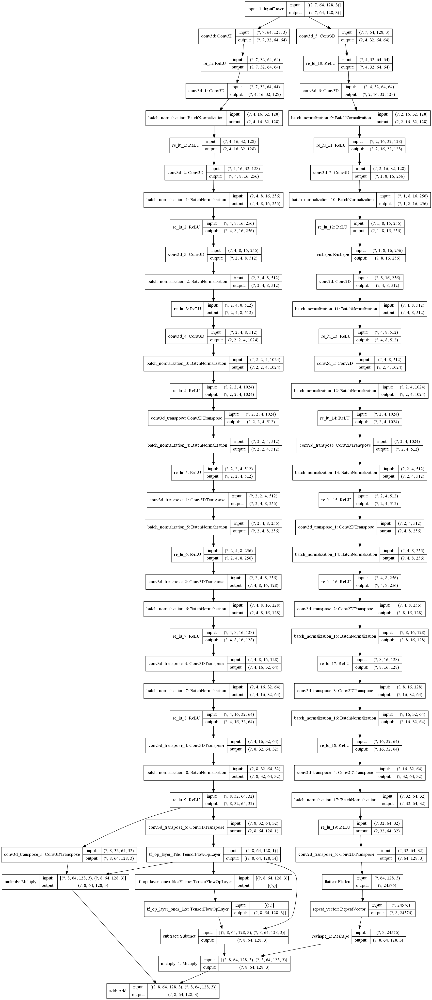

In [12]:
keras.utils.plot_model(c_vgan_generator, base_output_path + "img/c_vgan_generator.png", show_shapes=True)

Use the untrained generator to create a number of test videos from our example inputs:


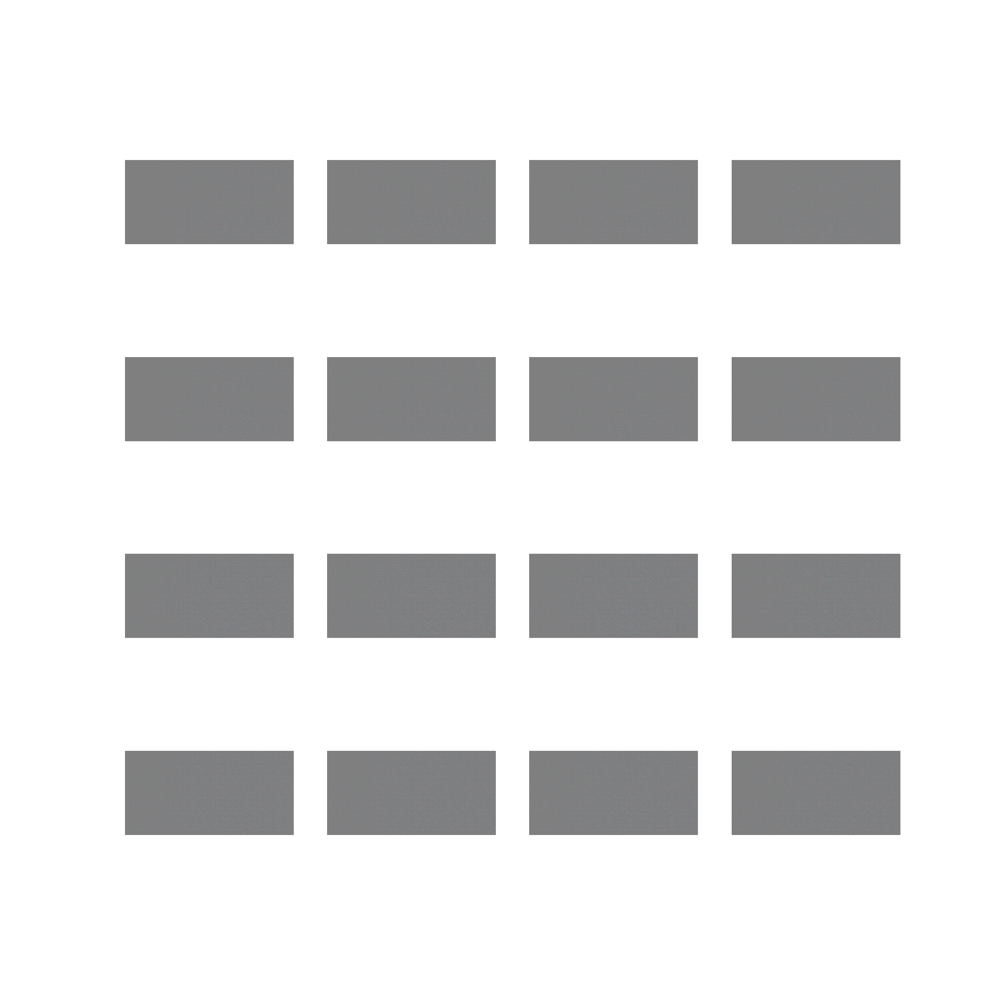

In [13]:
generated_test_videos = c_vgan_generator(examples_input, training=False).numpy()

anim_file_grid = base_output_path + "anim/test_example_grid.gif"
write_gif_grid(anim_file_grid, generated_test_videos, fps=5, dpi=600)
embed.embed_file(anim_file_grid)

### The Discriminator

The discriminator has not changed at all, so we simply call the external [module](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.py). For an extended documentation check the [VGAN notebook](https://gitlab.tubit.tu-berlin.de/sulandir/Thesis/blob/master/src/models/vgan.ipynb).

Create the discriminator, and test it with the first generated video from generated example batch.

In [14]:
c_vgan_discriminator = make_discriminator_model()

decision = c_vgan_discriminator(generated_test_videos[:1], training=False)
print(decision)

tf.Tensor([[-0.01396375]], shape=(1, 1), dtype=float32)


## Define the loss and optimizers

### Cross-Entropy

We do not use an activation function for the final layer in the discriminator model, so we use the binary cross entropy that is more numerical stable, using `from_logits=True`.

In [15]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

For the discriminator, nothing has changed; it still has to classify real videos as real (ones), and generated ones as fake (zeros):

In [16]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

### Generator loss

The generator's loss function is extended by a reconstruction error for the input frames `x` and the first seven generated frames `g`. This value is weighted by an additional hyperparameter lambda. For now, the parameter is set to `10`, as in our C-VGAN implementation. We once again chose the mean absolute error.

In [17]:
LAMBDA = 10
mean_abs_err = tf.keras.losses.MeanAbsoluteError()

def generator_loss(fake_output, x, g):
    fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    reconstruction_loss = mean_abs_err(x, g) * LAMBDA
    return fake_loss + reconstruction_loss

The optimizers are configured in the same way as in the normal VGAN:

In [18]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

## Save checkpoints

In [19]:
checkpoint_dir = base_output_path + "training_checkpoints/"
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=c_vgan_generator,
                                 discriminator=c_vgan_discriminator)

## Define the training loop

As with C-VGAN, we will not need any seeds for example outputs.

In [20]:
EPOCHS = 10

For each training step, the first 7 frames of a number of real videos (BATCH_SIZE) is used as input for the generator to produce a same number of videos that are each 8 frames long. The discriminator has to then classify these videos. In addition, the corresponding real videos are also fed to the discriminator to be classified. On the results the loss for both models is calculated, and the models are updated accordingly.

In [21]:
@tf.function
def train_step(batch):
    input_frames, input_videos = batch

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_videos = c_vgan_generator(input_frames, training=True)

        real_output = c_vgan_discriminator(input_videos, training=True)
        fake_output = c_vgan_discriminator(generated_videos, training=True)

        gen_loss = generator_loss(fake_output, input_frames, generated_videos[:,:7])
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, c_vgan_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, c_vgan_discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, c_vgan_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, c_vgan_discriminator.trainable_variables))

    return gen_loss, disc_loss

In [22]:
gen_train_loss = []
disc_train_loss = []

def train(epochs):
    # Load latest checkpoint if available
    latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
    checkpoint.restore(latest_checkpoint)
    if latest_checkpoint:
        print("Restored from {}".format(latest_checkpoint))
    else:
        print("Initializing from scratch.")

    for epoch in range(epochs):
        # Init batch loader for this epoch
        batch_loader = BatchLoader(uniform_sampler, max_queue_size=128, no_workers=4)

        # Init storage for losses of current epoch
        gen_epoch_loss = []
        disc_epoch_loss = []

        start = time.time()

        # Train models over the entire batch each epoch
        for _ in range(len(batch_loader)):
            batch = batch_loader.get_batch()
            gen_batch_loss, disc_batch_loss = train_step(batch)
            gen_epoch_loss.append(gen_batch_loss)
            disc_epoch_loss.append(disc_batch_loss)

        # Store loss of epoch for summary after training
        gen_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(gen_epoch_loss)))
        disc_train_loss.append(tf.math.reduce_mean(tf.convert_to_tensor(disc_epoch_loss)))

        # Produce this epoch's generated videos from the fixed seed
        display.clear_output(wait=True)
        generate_and_save_videos(c_vgan_generator, epoch + 1, examples_input)

        # Save the model every 2 epochs
        if (epoch + 1) % 2 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

        # Cleanup
        batch_loader.shutdown_workers()

    # Generate the last epoch's video from the fixed seed
    display.clear_output(wait=True)
    generate_and_save_videos(c_vgan_generator, epochs, examples_input)

## Generate and save videos

In [23]:
anim_file_dir = base_output_path + "anim/train/"

def generate_and_save_videos(model, epoch, test_input):
    predictions = model(test_input, training=False).numpy()

    anim_grid = anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch)
    write_gif_grid(anim_grid, predictions, fps=5, dpi=600)

## Train the model

Call the `train()` method defined above to train the generator and discriminator simultaneously. It is important to note however, that generator and discriminator do not overpower each other (else one of them will run into a dead end regarding improvement, causing the other one to be stuck as well).

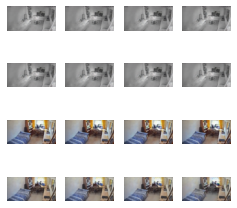

In [24]:
train(EPOCHS)

### Output training losses

In [25]:
epochs_arr = np.arange(EPOCHS)
gen_loss_arr = np.asarray(gen_train_loss)
disc_loss_arr = np.asarray(disc_train_loss)

training_loss = base_output_path + "img/training_loss.png"

plt.plot(epochs_arr, gen_loss_arr, "b", label="gen loss")
plt.plot(epochs_arr, disc_loss_arr, "y", label="disc loss")
plt.xlabel("epochs")
plt.xlabel("loss")
plt.legend(loc="upper right")

plt.savefig(training_loss)
plt.show()

Generator training loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=3.642744>, <tf.Tensor: shape=(), dtype=float32, numpy=3.5641837>, <tf.Tensor: shape=(), dtype=float32, numpy=3.63577>, <tf.Tensor: shape=(), dtype=float32, numpy=3.6719253>, <tf.Tensor: shape=(), dtype=float32, numpy=3.1241908>, <tf.Tensor: shape=(), dtype=float32, numpy=3.4641607>, <tf.Tensor: shape=(), dtype=float32, numpy=3.2069862>, <tf.Tensor: shape=(), dtype=float32, numpy=3.133136>, <tf.Tensor: shape=(), dtype=float32, numpy=3.5800316>, <tf.Tensor: shape=(), dtype=float32, numpy=3.4307528>]
Discriminator train loss per epoch: 	[<tf.Tensor: shape=(), dtype=float32, numpy=0.8042327>, <tf.Tensor: shape=(), dtype=float32, numpy=0.56050813>, <tf.Tensor: shape=(), dtype=float32, numpy=0.49170306>, <tf.Tensor: shape=(), dtype=float32, numpy=0.46737713>, <tf.Tensor: shape=(), dtype=float32, numpy=0.5429797>, <tf.Tensor: shape=(), dtype=float32, numpy=0.4535599>, <tf.Tensor: shape=(), dtype=float32, numpy=0.5

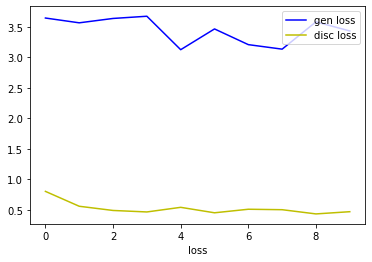

In [26]:
print("Generator training loss per epoch:",
      "\t" + str(gen_loss_arr))
print("Discriminator train loss per epoch:",
      "\t" + str(disc_loss_arr))

## Display any of the generated videos


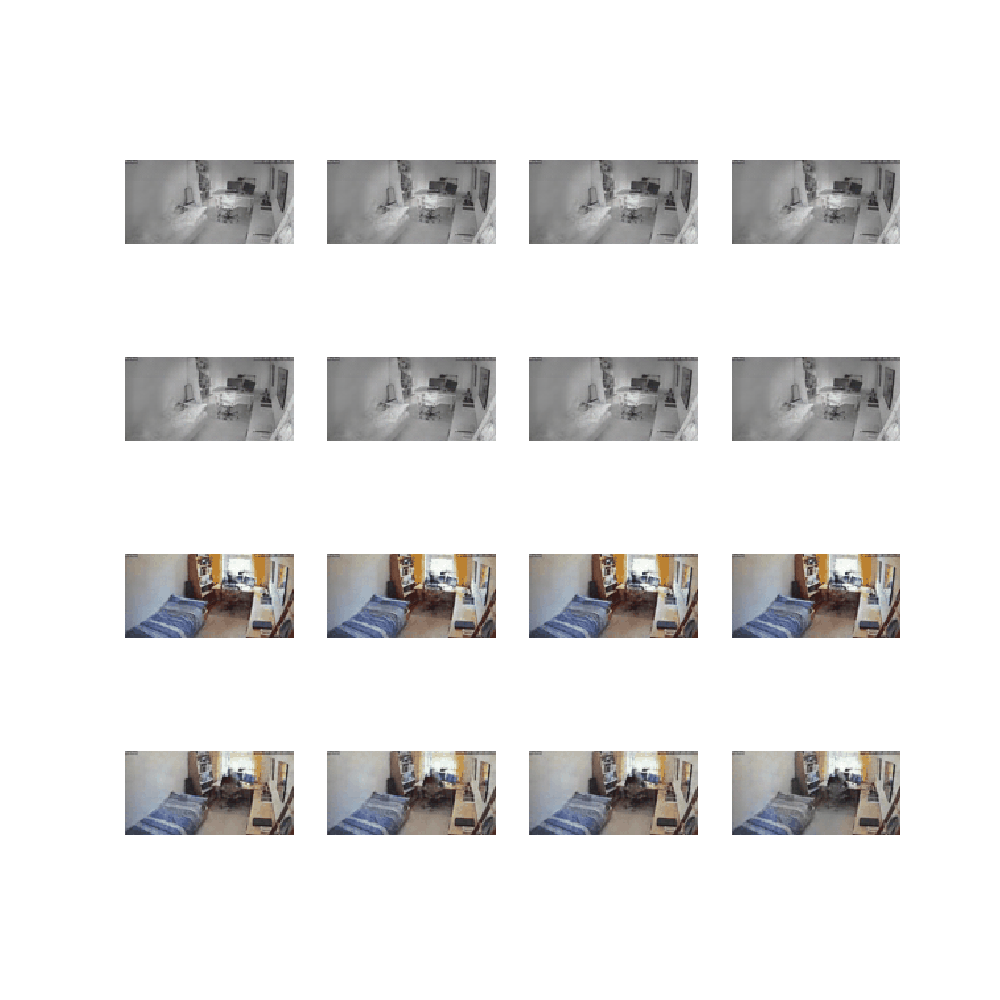

In [27]:
epoch_no = EPOCHS

embed.embed_file(anim_file_dir + "anim_at_epoch_{:04d}.gif".format(epoch_no))